<a href="https://colab.research.google.com/github/Tung0000/Train_Fruit_Yolov8s/blob/main/Train_Custom_test_updatev2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#ติดตั้ง Library ที่จำเป็น

#โหลด Dataset จาก Roboflow

In [1]:
!pip install ultralytics

In [2]:
import ultralytics
from ultralytics import YOLO

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#  เช็คโดยใช้ ImageDataGenerator

In [ ]:
#import matplotlib.pyplot as plt

In [ ]:
#import numpy as np
#import matplotlib.pyplot as plt
#from tensorflow.keras.preprocessing.image import ImageDataGenerator
#import tensorflow as tf

In [ ]:
##ImageDataGenerator()

In [ ]:
#datagen=ImageDataGenerator(rescale=1./255,zoom_range=0.2,brightness_range=[0.5,1.5], rotation_range=20,horizontal_flip=True)

#train_test=datagen.flow_from_directory(train_dir,target_size=(64,64),batch_size=32,class_mode='categorical')

In [ ]:
#datagen=ImageDataGenerator(rescale=1./255,zoom_range=0.2,brightness_range=[0.5,1.5], rotation_range=20,horizontal_flip=True)

#valid_test=datagen.flow_from_directory(valid_dir,target_size=(64,64),batch_size=32,class_mode='categorical')

In [ ]:
#x=train_test.samples
#y=train_test.class_indices
#z=train_test.num_classes
#a=train_test.batch_size
#print(x,y,z,a)

In [ ]:
#x=valid_test.samples
#y=valid_test.class_indices
#z=valid_test.num_classes
#a=valid_test.batch_size
#print(x,y,z,a)

In [ ]:
#plt.imshow(train_test[0][0][0])

In [ ]:
#train_test.class_indices

In [ ]:
#ids,counts= np.unique(train_test.classes, return_counts=True)
#print(f"มี class เท่ากับ {ids}")
#print(counts)

In [ ]:
#labels = (train_test.class_indices)
#labels = dict((v,k) for k,v in labels.items())
#labels

#for i in ids:
#    print('{:>6} = {}' . format(labels[i], counts[i]))

In [ ]:
#train_test[0][0][0].shape

In [ ]:
#valid_test[0][0][0].shape

#  Train Model Yolo ด้วย Dataset ที่เตรียมไว้

In [7]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="0100tTC6iSisNdselYOb")
project = rf.workspace("object-detection-fruit").project("fruit-smrhb")
version = project.version(7)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...


In [8]:
models = YOLO("yolov8s.pt")

In [9]:
dataset="/content/Fruit-7/data.yaml"

#ใช้ Augmentation มาช่วย

In [10]:
from ultralytics import YOLO

# โหลดโมเดล
model = YOLO("yolov8s.pt")

# เทรนพร้อม custom augmentation
model.train(
    data=dataset,
    epochs=30,
    imgsz=640,
    augment=True,  # เปิดใช้ augmentation
    degrees=20,    # หมุน
    scale=0.5,     # random scale
    flipud=0.3,    # flip vertical
    fliplr=0.5,    # flip horizontal
    hsv_h=0.015,   # ปรับ hue
    hsv_s=0.7,     # ปรับ saturation
    hsv_v=0.4      # ปรับ brightness
)


Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Fruit-7/data.yaml, degrees=20, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.3, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0,

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c40d72b1580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

#โหลด model แบบบลดขนาด

In [11]:
from ultralytics import YOLO

# โหลดโมเดลที่ train เสร็จ
model = YOLO("/content/best.pt")

# Export เป็น ONNX
model.export(format="onnx", opset=12)

# Export เป็น TFLite แบบ quantized INT8
model.export(format="tflite", int8=True)

Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.30GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/
Model summary (fused): 72 layers, 11,129,454 parameters, 0 gradients, 28.5 GFLOPs

PyTorch: starting from '/content/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (21.5 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim>=0.1.67', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 9.2s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.19.1rc1 opset 12...
ONNX: slimming with onnxslim 0.1.70...
ONNX: export success ✅ 11.3s, saved as '/content/best.onnx' (42.7 MB)

Export complete (12.6s)
Results saved to /content
Predict:         yolo predict task=detect model=/content/best.onnx imgsz=640  
Validate:   

'/content/best_saved_model/best_int8.tflite'

#เช็ต parameters

In [12]:
from ultralytics import YOLO

models = YOLO(model)
total_params = sum(p.numel() for p in model.model.parameters())
print(f"Total parameters: {total_params/1e6:.2f} M")

Total parameters: 11.14 M


#แสดงผลลัพธ์จากการ Train Model





##แสดง Confusion Metrix

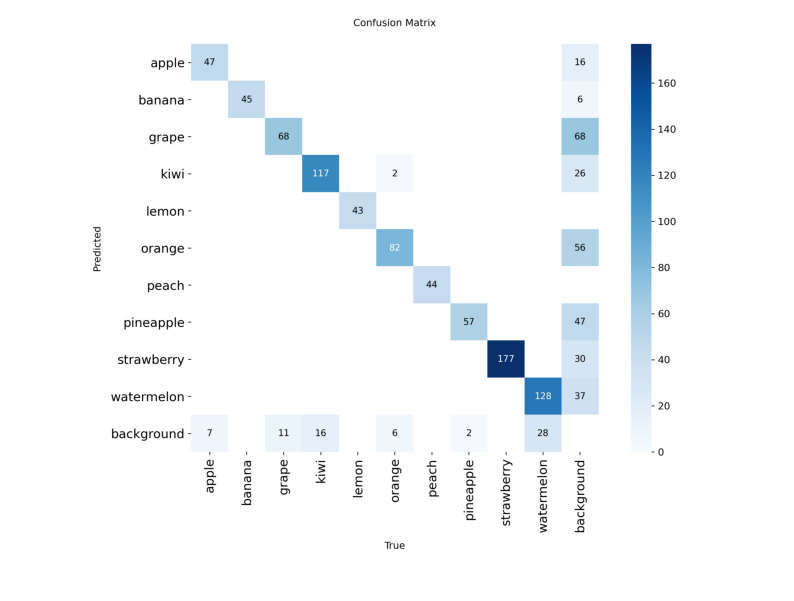

In [13]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img=mpimg.imread('/content/runs/detect/train/confusion_matrix.png')
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.axis("off")
plt.show()

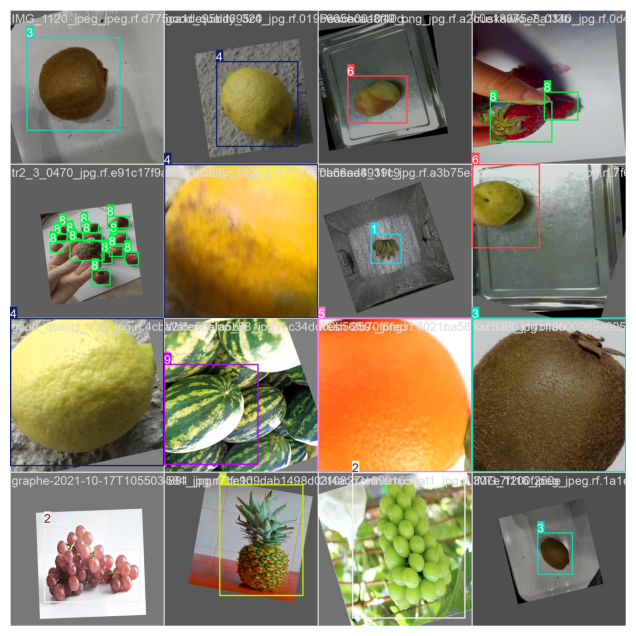

In [15]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('/content/runs/detect/train/train_batch1941.jpg')
plt.figure(figsize=(10,8))
plt.imshow(img)
plt.axis("off")
plt.show()

##แสดงภาพตัวอย่างที่ทำนายแล้ว จากการ Valid

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# โหลดรูป
img_left = mpimg.imread('/content/runs/detect/train/val_batch0_labels.jpg')
img_right = mpimg.imread('/content/runs/detect/train/val_batch0_pred.jpg')

plt.figure(figsize=(15, 15))  # กำหนดขนาดรวม

# รูปซ้าย (index=1)
plt.subplot(1, 2, 1)
plt.imshow(img_left)
plt.axis("on")

# รูปขวา (index=2)
plt.subplot(1, 2, 2)
plt.imshow(img_right)
plt.axis("on")

plt.show()

#ดาวน์โหลด Model ไปใช้

In [3]:
from google.colab import files
# ระบุเส้นทางของไฟล์ที่ต้องการดาวน์โหลด
file_path ='/content/best.pt'
# ดาวน์โหลดไฟล์
files.download(file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# การนำโมเดลที่สำเร็จแล้วมาใช้ (ใน Colab)

In [16]:
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab import files
import os

## อัพโหลดไฟล์รูปที่ต้องการค้นหาวัตถุ เพิ่มแบบปกติเอาก็ได้

In [ ]:
"""
uploaded = files.upload("")  # เรียกใช้ตัวอัพโหลดรูปของ Colab
if not uploaded:
    raise FileNotFoundError("No file uploaded!")
test_image_path = next(iter(uploaded.keys()))  # เก็บชื่อไฟล์เข้าสู่ตัวแปร
"""

## เรียกใช้โมเดลที่ Train ไว้แล้ว

In [17]:
model_best_pt="/content/best.pt"

In [18]:
# โหลดโมเดล best
model_path = model_best_pt
model = YOLO(model_path)

In [19]:
model.info()

Model summary: 129 layers, 11,139,470 parameters, 0 gradients, 28.7 GFLOPs


(129, 11139470, 0, 28.666316800000004)

 กำลังประมวลผล: /content/2583475-hd_1920_1080_24fps.mp4 (ดึงข้อมูลดิบ + แสดงผล)

video 1/1 (frame 1/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.5ms

--- [Frame 0] DATA (0 Detections) ---


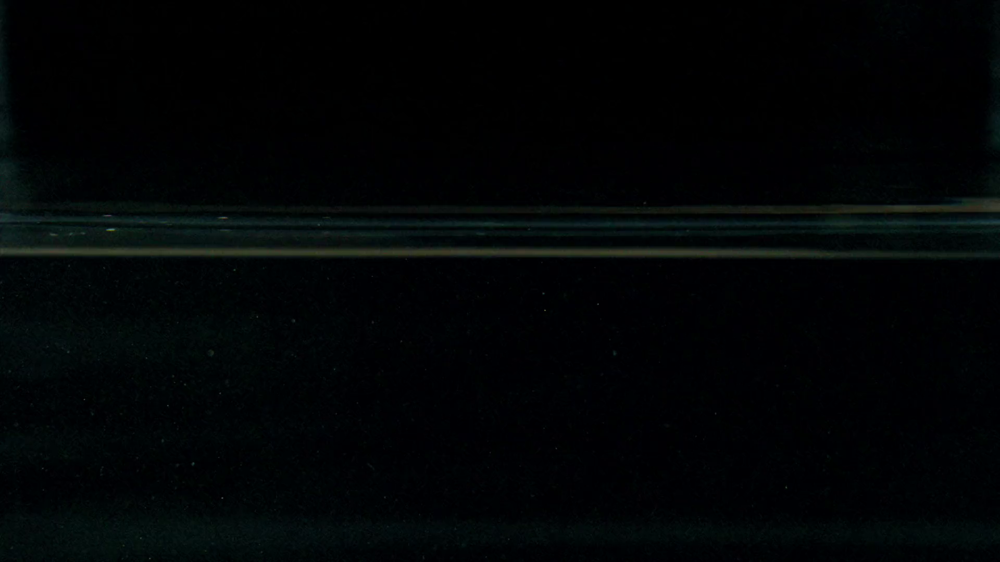

video 1/1 (frame 2/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.4ms
video 1/1 (frame 3/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.0ms
video 1/1 (frame 4/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.4ms
video 1/1 (frame 5/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 6/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.6ms
video 1/1 (frame 7/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.4ms
video 1/1 (frame 8/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.2ms
video 1/1 (frame 9/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 10/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 11/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.1ms
video 1/1 (frame 12/366) /co

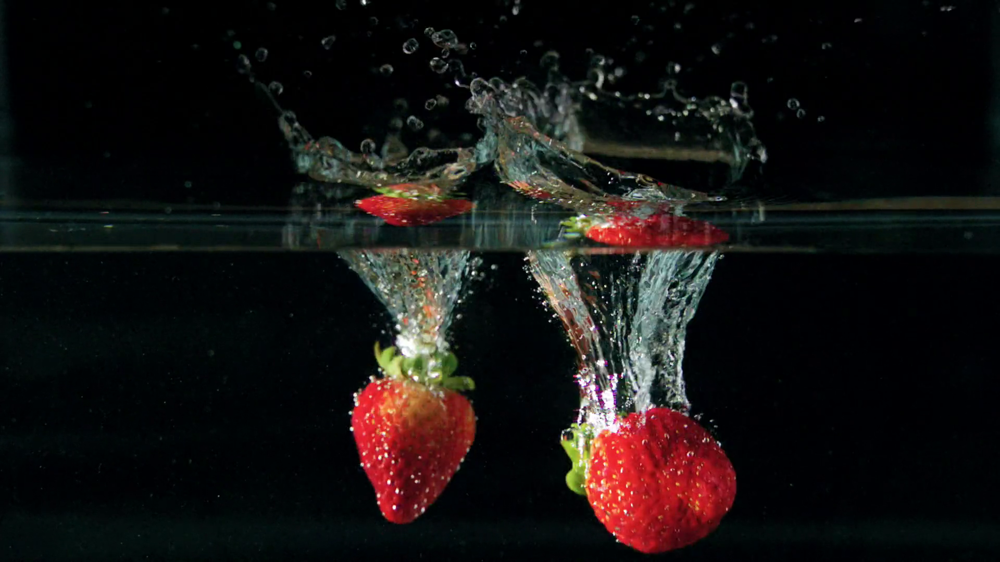

video 1/1 (frame 32/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.8ms
video 1/1 (frame 33/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 2 strawberrys, 21.3ms
video 1/1 (frame 34/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 2 strawberrys, 19.1ms
video 1/1 (frame 35/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 15.7ms
video 1/1 (frame 36/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 15.6ms
video 1/1 (frame 37/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 2 strawberrys, 16.0ms
video 1/1 (frame 38/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 20.4ms
video 1/1 (frame 39/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 40/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 20.0ms
video 1/1 (frame 41/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 26.9ms
video 1/1 (frame 42/366) /content/2583475

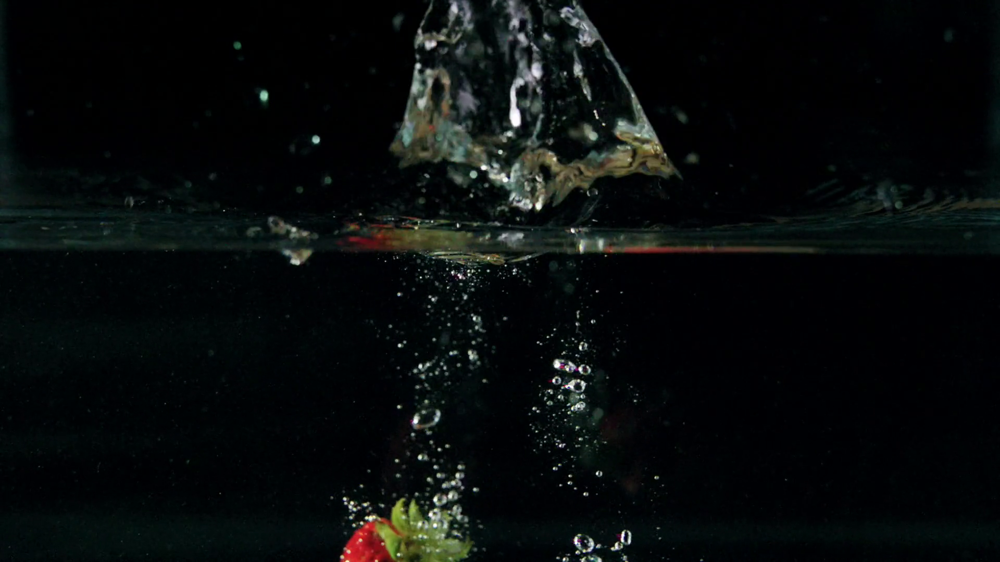

video 1/1 (frame 62/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 23.6ms
video 1/1 (frame 63/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.8ms
video 1/1 (frame 64/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 14.3ms
video 1/1 (frame 65/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.4ms
video 1/1 (frame 66/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 21.2ms
video 1/1 (frame 67/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.1ms
video 1/1 (frame 68/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.0ms
video 1/1 (frame 69/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.9ms
video 1/1 (frame 70/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 17.1ms
video 1/1 (frame 71/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.2ms
video 1/1 (frame 72/

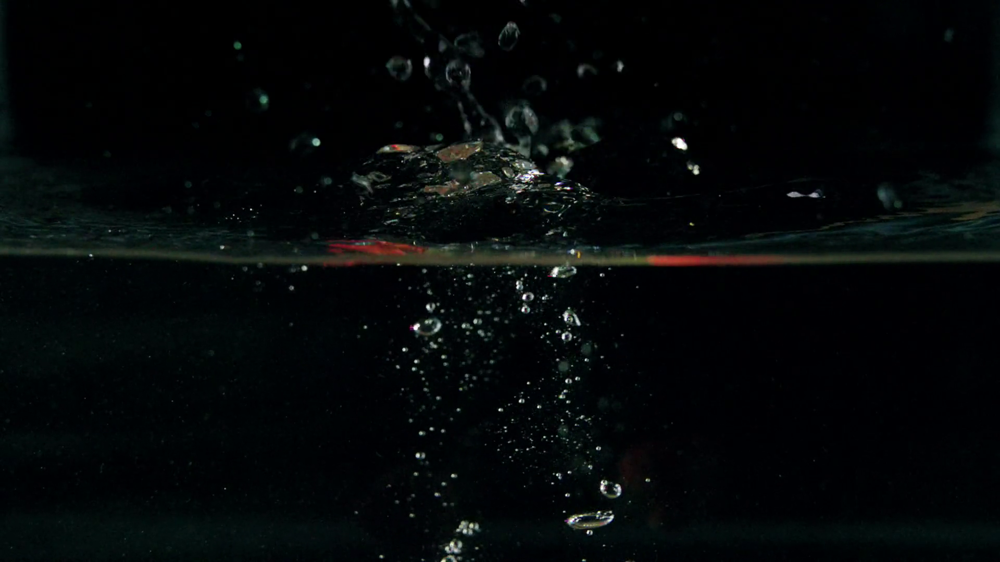

video 1/1 (frame 92/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.6ms
video 1/1 (frame 93/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.5ms
video 1/1 (frame 94/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 17.8ms
video 1/1 (frame 95/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.5ms
video 1/1 (frame 96/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 17.3ms
video 1/1 (frame 97/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 18.2ms
video 1/1 (frame 98/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.9ms
video 1/1 (frame 99/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.4ms
video 1/1 (frame 100/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.5ms
video 1/1 (frame 101/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.2ms
video 1/1 (frame 1

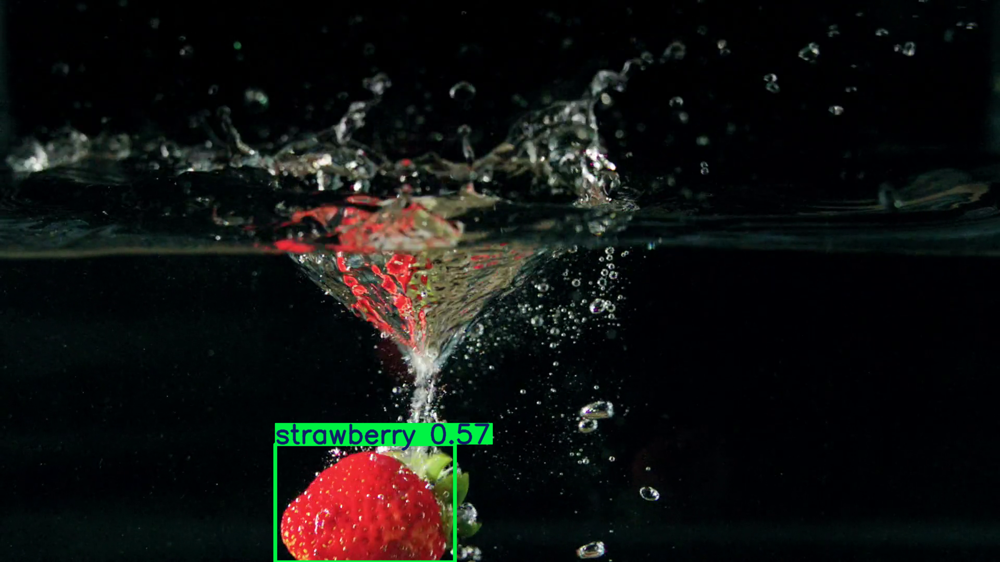

video 1/1 (frame 122/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 27.7ms
video 1/1 (frame 123/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.0ms
video 1/1 (frame 124/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.8ms
video 1/1 (frame 125/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 126/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.6ms
video 1/1 (frame 127/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 128/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.6ms
video 1/1 (frame 129/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 130/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 21.0ms
video 1/1 (frame 131/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (fr

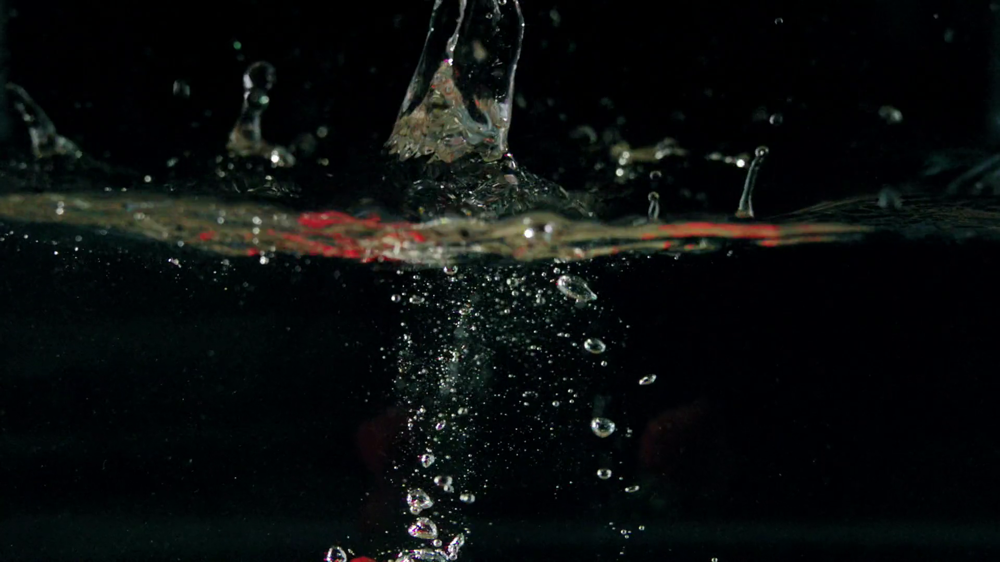

video 1/1 (frame 152/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 21.5ms
video 1/1 (frame 153/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.9ms
video 1/1 (frame 154/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 14.5ms
video 1/1 (frame 155/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 156/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 157/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.6ms
video 1/1 (frame 158/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.1ms
video 1/1 (frame 159/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.1ms
video 1/1 (frame 160/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.0ms
video 1/1 (frame 161/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 18.0ms
video 1/1 

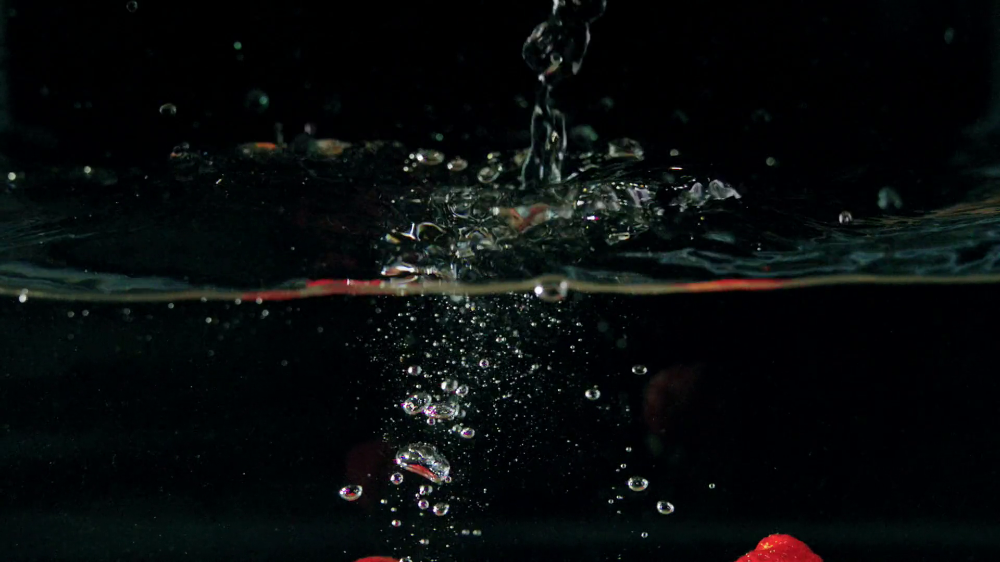

video 1/1 (frame 182/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.0ms
video 1/1 (frame 183/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.2ms
video 1/1 (frame 184/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.6ms
video 1/1 (frame 185/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 20.7ms
video 1/1 (frame 186/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.4ms
video 1/1 (frame 187/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.7ms
video 1/1 (frame 188/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.3ms
video 1/1 (frame 189/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.4ms
video 1/1 (frame 190/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 20.0ms
video 1/1 (frame 191/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 13.0ms
video 1/1 

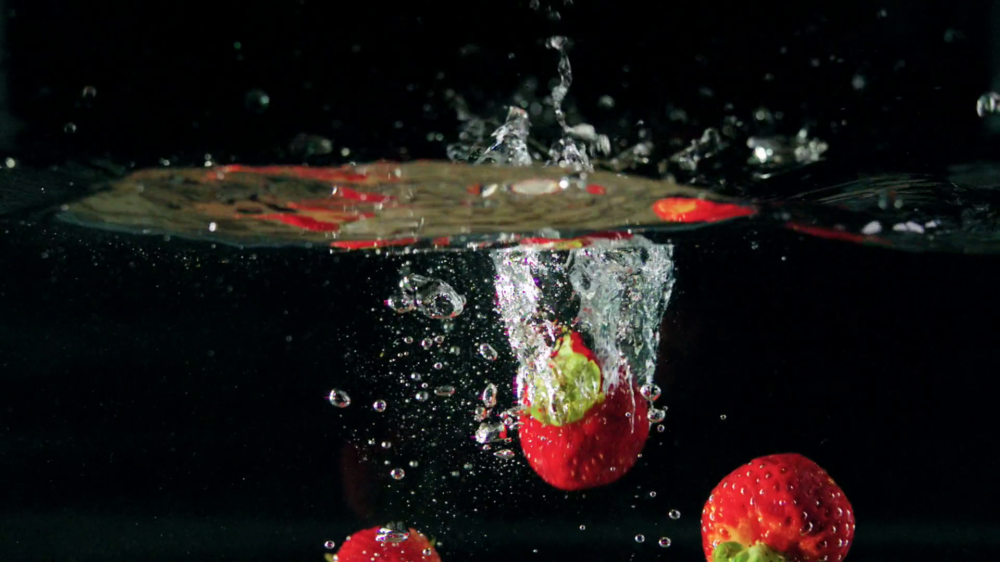

video 1/1 (frame 212/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 21.7ms
video 1/1 (frame 213/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.1ms
video 1/1 (frame 214/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.4ms
video 1/1 (frame 215/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 216/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 21.1ms
video 1/1 (frame 217/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 12.9ms
video 1/1 (frame 218/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 17.4ms
video 1/1 (frame 219/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 220/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.0ms
video 1/1 (frame 221/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 13.0ms
video 1/1 (fr

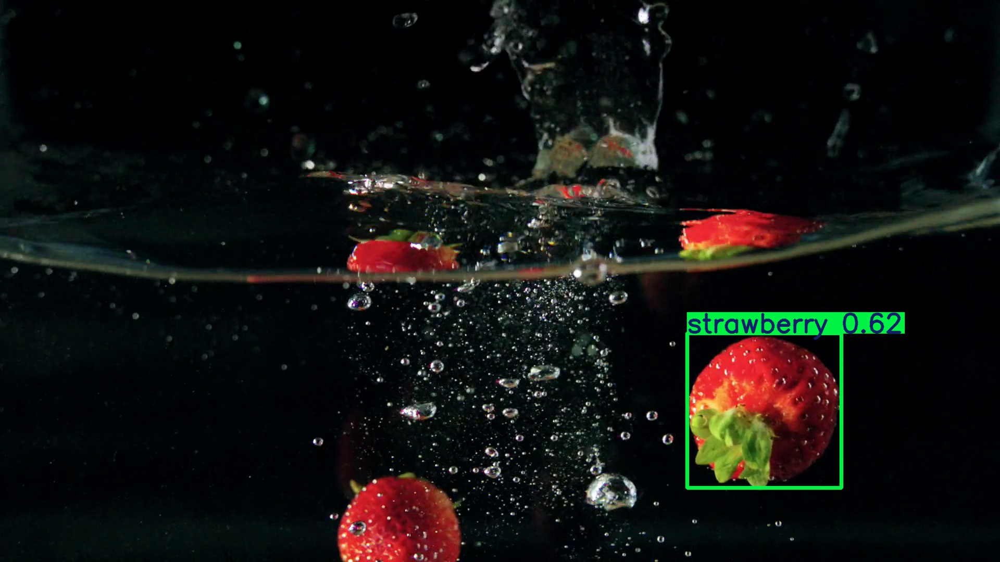

video 1/1 (frame 242/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 16.2ms
video 1/1 (frame 243/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 18.4ms
video 1/1 (frame 244/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 245/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 18.7ms
video 1/1 (frame 246/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 247/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 14.6ms
video 1/1 (frame 248/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 15.2ms
video 1/1 (frame 249/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 16.7ms
video 1/1 (frame 250/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 22.5ms
video 1/1 (frame 251/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 26.1ms
video 1/1 (frame 252/366) /content

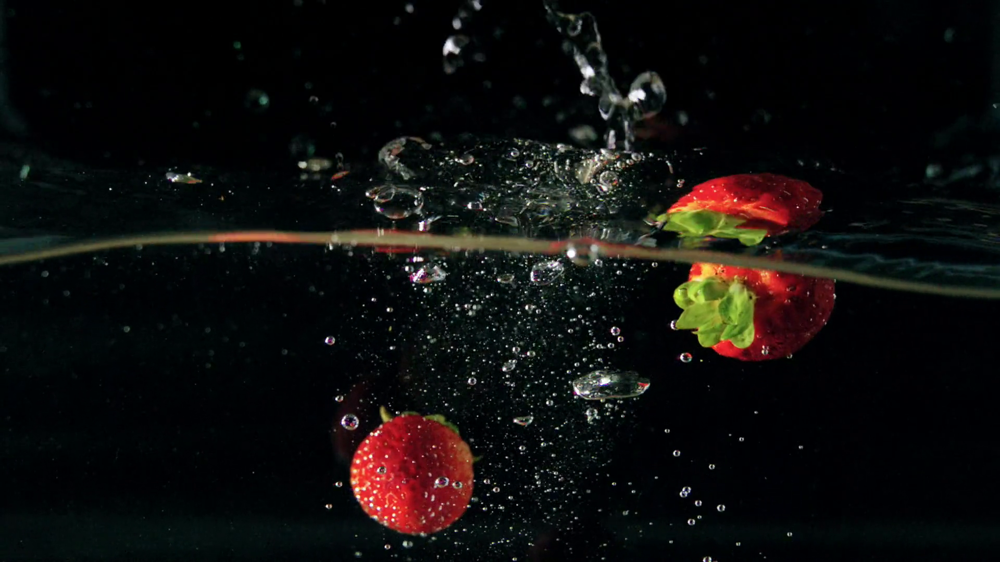

video 1/1 (frame 272/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 11.1ms
video 1/1 (frame 273/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 14.1ms
video 1/1 (frame 274/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 275/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 276/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 19.2ms
video 1/1 (frame 277/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 278/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
video 1/1 (frame 279/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 280/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 10.8ms
video 1/1 (frame 281/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 14.8ms
video 1/1 (frame 282/3

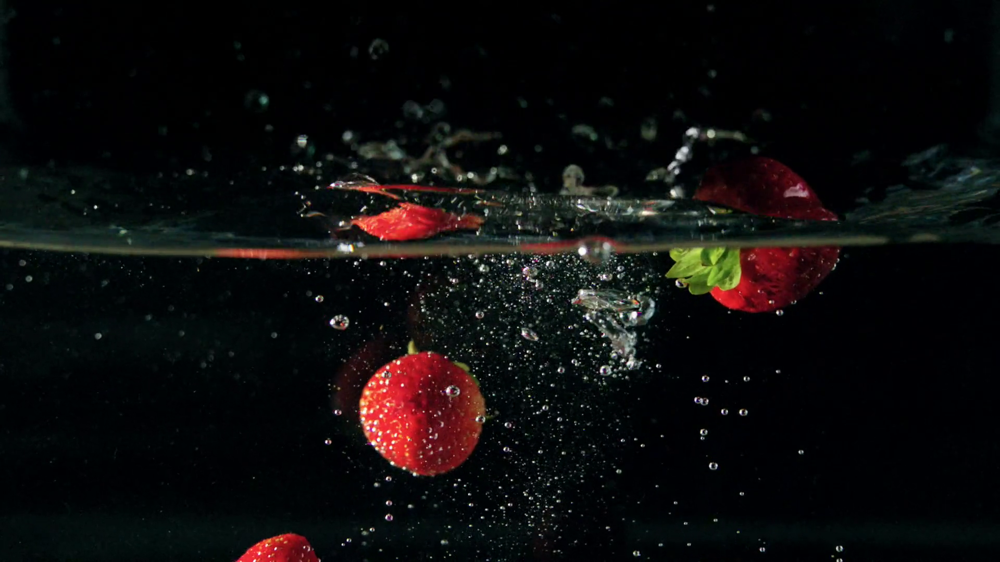

video 1/1 (frame 302/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.9ms
video 1/1 (frame 303/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.4ms
video 1/1 (frame 304/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.5ms
video 1/1 (frame 305/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.9ms
video 1/1 (frame 306/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.0ms
video 1/1 (frame 307/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 19.4ms
video 1/1 (frame 308/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 15.3ms
video 1/1 (frame 309/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 17.7ms
video 1/1 (frame 310/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.7ms
video 1/1 (frame 311/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.1ms
video 1/1 

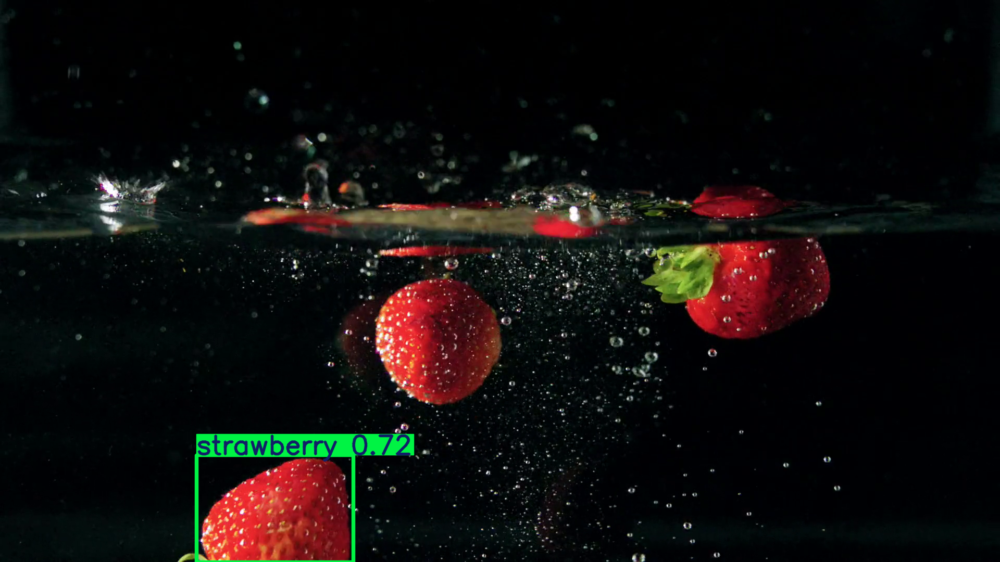

video 1/1 (frame 332/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 21.5ms
video 1/1 (frame 333/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 18.8ms
video 1/1 (frame 334/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 18.7ms
video 1/1 (frame 335/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 14.7ms
video 1/1 (frame 336/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 13.3ms
video 1/1 (frame 337/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 2 strawberrys, 16.4ms
video 1/1 (frame 338/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 20.0ms
video 1/1 (frame 339/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 14.6ms
video 1/1 (frame 340/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 15.5ms
video 1/1 (frame 341/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 17.1ms
video 1/1 (frame 342/366) /content/2583

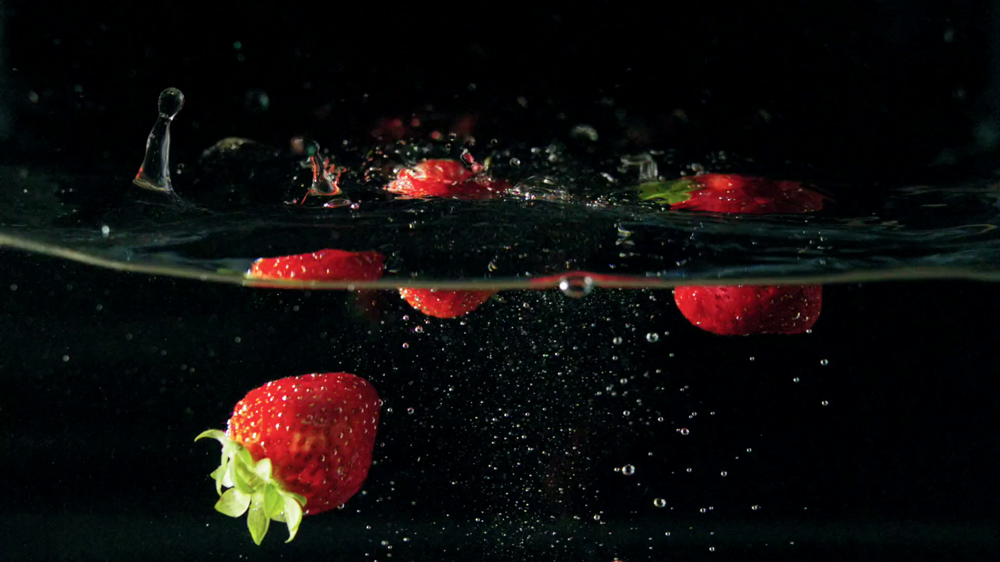

video 1/1 (frame 362/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 (no detections), 16.6ms
video 1/1 (frame 363/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 14.3ms
video 1/1 (frame 364/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 12.6ms
video 1/1 (frame 365/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 19.1ms
video 1/1 (frame 366/366) /content/2583475-hd_1920_1080_24fps.mp4: 384x640 1 strawberry, 10.8ms
Speed: 6.8ms preprocess, 15.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Results saved to /content/Video_Detection/YOLO_Output
 การประมวลผลเสร็จสมบูรณ์


In [23]:
from ultralytics import YOLO
import os
import cv2
from google.colab.patches import cv2_imshow # จำเป็นสำหรับการแสดงผลใน Google Colab

# ----------------------------------------------------
#  สำคัญ: โค้ดส่วนนี้ต้องรันนอกฟังก์ชัน
# ----------------------------------------------------
# 1. กำหนดและโหลดโมเดล
model_path = model_best_pt # <<< ตรวจสอบ/เปลี่ยนพาธโมเดลของคุณ

if not os.path.exists(model_path):
    print(f"กำลังใช้โมเดลตั้งต้น: {model_path} (จะถูกดาวน์โหลดหากยังไม่มี)")
try:
    model = YOLO(model_path)
except Exception as e:
    print(f"Error: ไม่สามารถโหลดโมเดล YOLO จาก {model_path} ได้")
    model = None # ตั้งให้เป็น None เพื่อป้องกัน Error ในฟังก์ชัน

# ----------------------------------------------------
# ฟังก์ชันหลักสำหรับการรัน Inference, ดึงข้อมูล และแสดงผล
# ----------------------------------------------------
def run_yolo_inference_and_display(file_path, model, conf_thres=0.50, iou_thres=0.45, show_interval=30):
    """
    รัน Inference และดึงข้อมูลการตรวจจับแบบละเอียด พร้อมแสดงผลการวาดกล่องใน Colab

    Args:
        file_path (str/int): พาธไฟล์ภาพ/วิดีโอ หรือ ID กล้อง (เช่น 0)
        model (YOLO): วัตถุโมเดล YOLO ที่โหลดไว้
        conf_thres (float): Confidence threshold
        iou_thres (float): IoU threshold
        show_interval (int): แสดงผลเฟรมที่ถูกวาดทุกๆ N เฟรม (ช่วยป้องกัน Notebook ค้าง)

    Returns:
        list: รายการของข้อมูลการตรวจจับทั้งหมดในทุกเฟรม
    """

    if model is None:
        print(" โมเดลยังไม่ได้ถูกโหลด กรุณาตรวจสอบ model_path")
        return []

    # ตรวจสอบพาธ
    if isinstance(file_path, str) and not os.path.exists(file_path):
        raise FileNotFoundError(f"File not found at {file_path}")

    print(f" กำลังประมวลผล: {file_path} (ดึงข้อมูลดิบ + แสดงผล)")

    # รัน Prediction โดยใช้ stream=True
    results_generator = model.predict(
        source=file_path,
        conf=conf_thres,
        iou=iou_thres,
        show=False,          # ปิด show=False ที่นี่ แล้วไปใช้ cv2_imshow แทน
        stream=True,
        save=True,
        project='/content/Video_Detection',
        name='YOLO_Output',
        exist_ok=True,
    )

    all_detection_data = []
    frame_index = 0

    # วนลูปเพื่อดึงข้อมูลทีละเฟรม
    for result in results_generator:

        # 1. ดึงข้อมูลดิบ (Detection Data)
        boxes = result.boxes
        frame_data = {
            "frame_id": frame_index,
            "detections": []
        }

        if boxes is not None and len(boxes) > 0:
            # ใช้ .cpu().numpy() เพื่อดึงข้อมูลออกจาก Tensor
            xyxy_coords = boxes.xyxy.cpu().numpy()
            confidences = boxes.conf.cpu().numpy()
            class_ids = boxes.cls.cpu().numpy().astype(int)

            for box, conf, cls_id in zip(xyxy_coords, confidences, class_ids):
                detection = {
                    "class_id": cls_id.item(),
                    "class_name": model.names[cls_id.item()],
                    "confidence": float(f"{conf:.4f}"),  # ค่าความแม่นยำ
                    "bbox_xyxy": [float(f"{c:.2f}") for c in box], # พิกัดกล่อง
                }
                frame_data["detections"].append(detection)

        # 2. แสดงผลข้อมูลดิบ (สำหรับส่งไปหน้าเว็บ)
        if frame_index % show_interval == 0:
            print(f"\n--- [Frame {frame_index}] DATA ({len(frame_data['detections'])} Detections) ---")
            for det in frame_data["detections"]:
                # ข้อมูลนี้คือสิ่งที่คุณจะใช้บนเว็บไซต์
                print(f"  > Class: {det['class_name']} | Conf: {det['confidence']} | BBox: {det['bbox_xyxy']}")

        # 3. วาดผลลัพธ์ (Prediction Visuals)
        # result.plot() คืนค่า annotated frame (เป็น numpy array/image)
        annotated_frame = result.plot()

        # 4. แสดงผลใน Colab/Jupyter (ใช้ cv2_imshow)
        if frame_index % show_interval == 0:
            # แสดงภาพที่วาดกล่องแล้ว
            cv2_imshow(annotated_frame)

        all_detection_data.append(frame_data)
        frame_index += 1

        # สำคัญ: cv2.waitKey(1) จำเป็นสำหรับ Real-time streams
        if isinstance(file_path, int):
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break

    print(" การประมวลผลเสร็จสมบูรณ์")
    return all_detection_data

# ----------------------------------------------------
# 5. ส่วนการเรียกใช้งาน (รันโค้ดนี้)
# ----------------------------------------------------

# กำหนดไฟล์อินพุต
file_path = "/content/2583475-hd_1920_1080_24fps.mp4" # <-- วิดีโอ
#file_path = 0 # <-- สำหรับ Webcam

if 'model' in locals() and model:
    detection_results = run_yolo_inference_and_display(
        file_path=file_path,
        model=model,
        conf_thres=0.50,
        show_interval=30 # แสดงภาพวาดทุกๆ 30 เฟรม (1 วินาที ที่ 30fps)
    )
else:
    print(" ไม่สามารถรันได้เนื่องจากโมเดลยังไม่ได้ถูกโหลด โปรดตรวจสอบ 'model_path' และรันส่วนโหลดโมเดล")


   frame_id  class_name  confidence
0        32  strawberry      0.6700
1        32  strawberry      0.6432
2        33  strawberry      0.6292
3        33  strawberry      0.5281
4        34  strawberry      0.5097


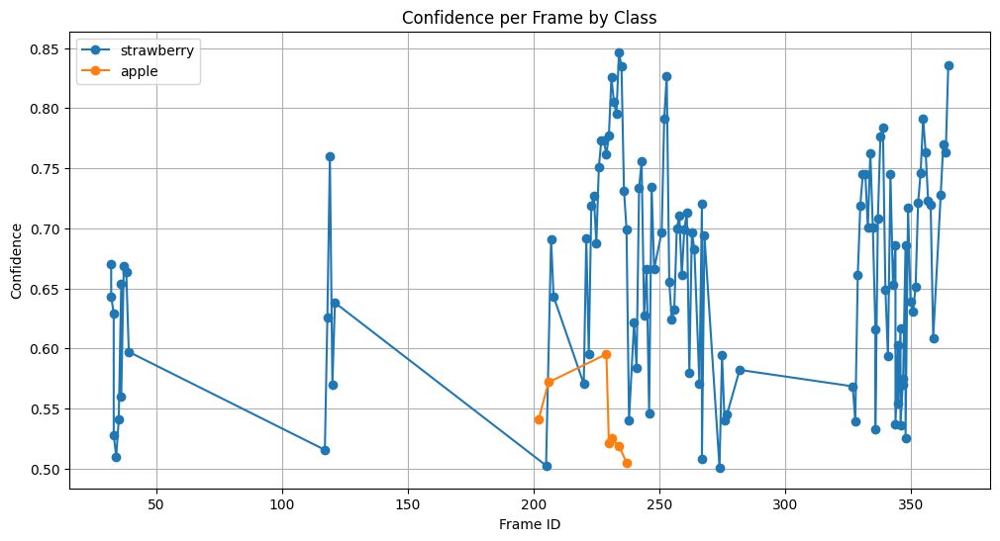

In [24]:
import pandas as pd
import matplotlib.pyplot as plt

# แปลง detection_results เป็น DataFrame
rows = []
for frame in detection_results:
    for det in frame["detections"]:
        rows.append({
            "frame_id": frame["frame_id"],
            "class_name": det["class_name"],
            "confidence": det["confidence"]
        })

df = pd.DataFrame(rows)

# ดูข้อมูลตัวอย่าง
print(df.head())

# 🔹 วาดกราฟ Confidence ต่อเฟรม
plt.figure(figsize=(12,6))
for class_name in df["class_name"].unique():
    subset = df[df["class_name"] == class_name]
    plt.plot(subset["frame_id"], subset["confidence"], marker="o", label=f"{class_name}")

plt.title("Confidence per Frame by Class")
plt.xlabel("Frame ID")
plt.ylabel("Confidence")
plt.legend()
plt.grid(True)
plt.show()


In [22]:
print(model.names)

{0: 'apple', 1: 'banana', 2: 'grape', 3: 'kiwi', 4: 'lemon', 5: 'orange', 6: 'peach', 7: 'pineapple', 8: 'strawberry', 9: 'watermelon'}
